# DIP Project - Stress Fibers 

In [119]:
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import cv2
from skimage.filters import frangi, threshold_otsu
from skimage.exposure import rescale_intensity
from scipy.ndimage import maximum_filter, minimum_filter

In [120]:
def show(*args):
    images = len(args)
    rows = int(np.ceil(images / 5.0))   
    cols = min(5, images)              

    fig, ax = plt.subplots(rows, cols, figsize=(8 * cols, 8 * rows))

    for i, img in enumerate(args):
        if rows == 1:  
            if cols == 1: 
                ax.imshow(img, cmap='gray')
            else:  
                ax[i].imshow(img, cmap='gray')
        else: 
            row = i // 5
            col = i % 5
            ax[row, col].imshow(img, cmap='gray')

    if images < rows * cols:
        for i in range(images, rows * cols):
            fig.delaxes(ax.flatten()[i])
    plt.tight_layout()
    plt.show()

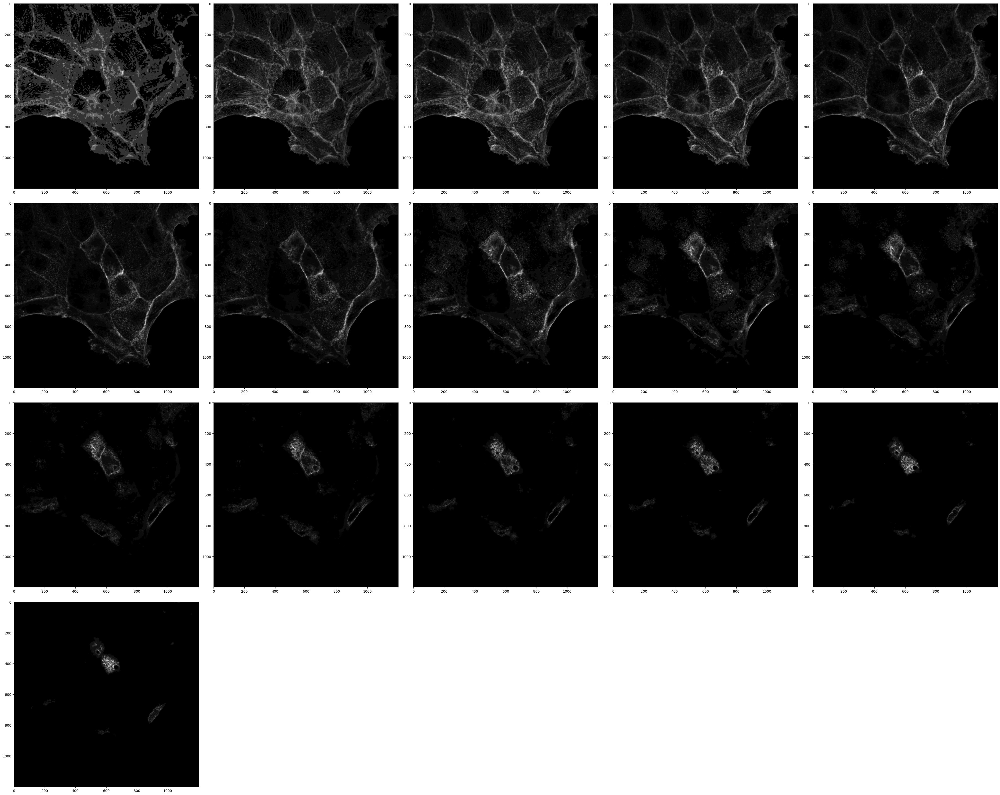

In [121]:
_, image1 = cv2.imreadmulti("pic1.tif")
# _, image1 = cv2.imreadmulti("pic2.tif")
show(*image1)

To achieve a clearer image with both cells and fibers, we combine the layers and process them together. 
By combining the layers, we can enhance the visibility of both cell structures and fiber details, resulting in a clearer overall image.

In [122]:
def enhance_contrast(layer):
    if layer.dtype != np.uint8:
        layer = cv2.normalize(layer, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
    equalized = cv2.equalizeHist(layer)
    return equalized

def emphasize_boundaries(layer):
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    eroded = cv2.erode(layer, kernel, iterations=1)
    dilated = cv2.dilate(eroded, kernel, iterations=1)
    return dilated

def combine_layers(layers):
    combined = np.maximum.reduce(layers)
    combined = cv2.normalize(combined, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
    return combined

def process_image(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    stacked_layers = cv2.split(image)
    tiff_stack = cv2.imreadmulti(image_path)[1]
    enhanced_layers = []
    for layer in stacked_layers:
        enhanced = enhance_contrast(layer)
        emphasized = emphasize_boundaries(enhanced)
        enhanced_layers.append(emphasized)

    bounded_img = tiff_stack[-1] - tiff_stack[1]
    bounded_img = cv2.GaussianBlur(bounded_img, (35,35), 10)
    bounded_img[bounded_img > 0] = 255

    final_output = combine_layers(enhanced_layers)        
    final_output[bounded_img == 0] = 0
    return final_output

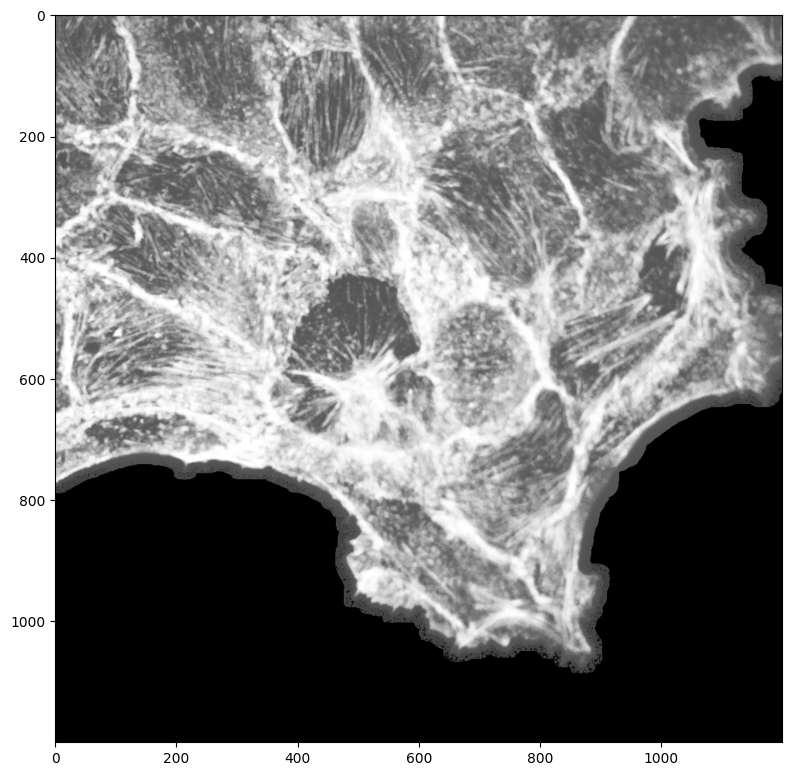

In [123]:
proccessed_image = process_image('pic1.tif')
show(proccessed_image)

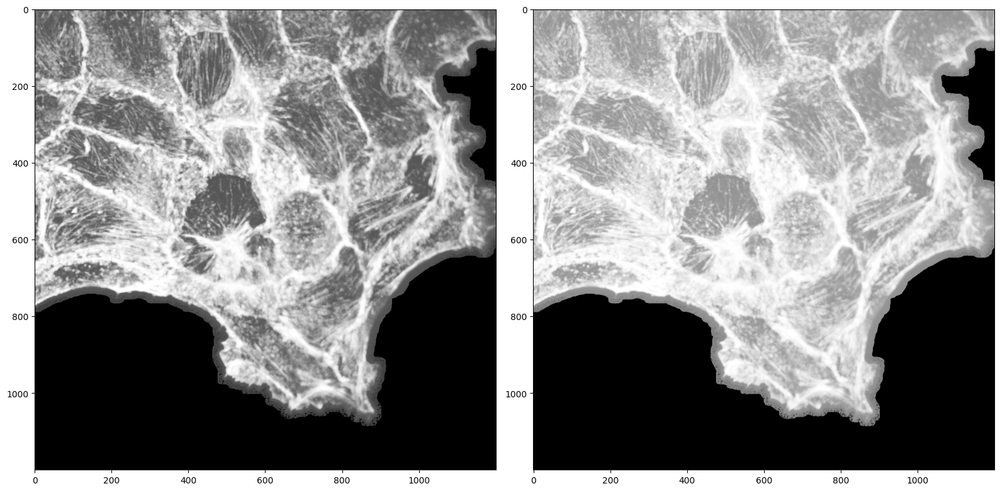

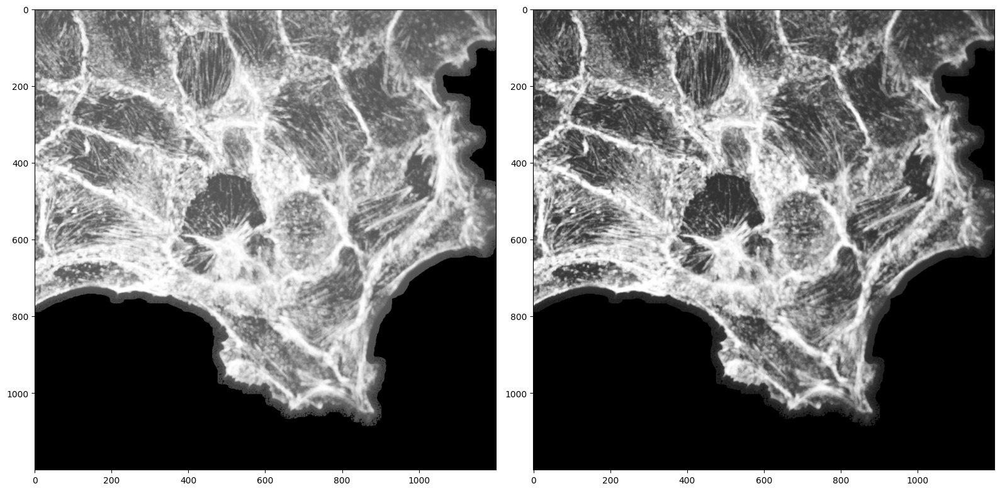

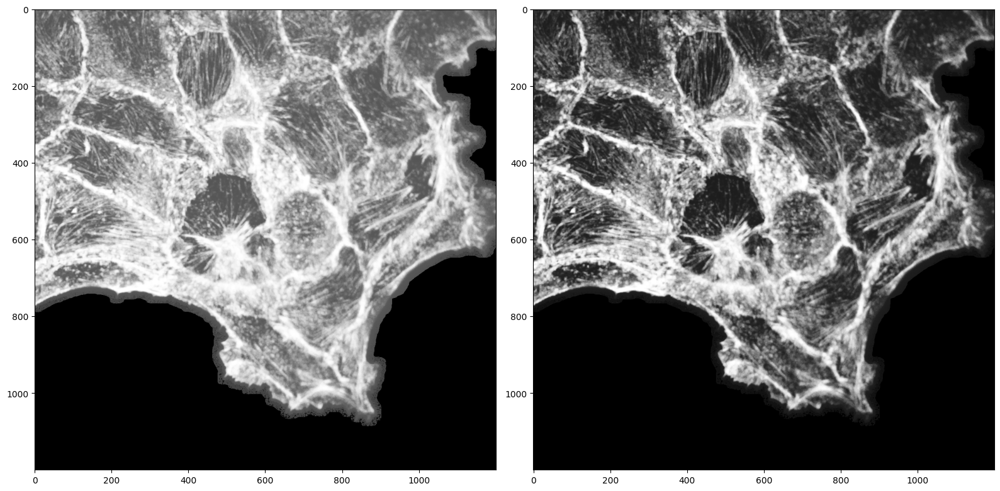

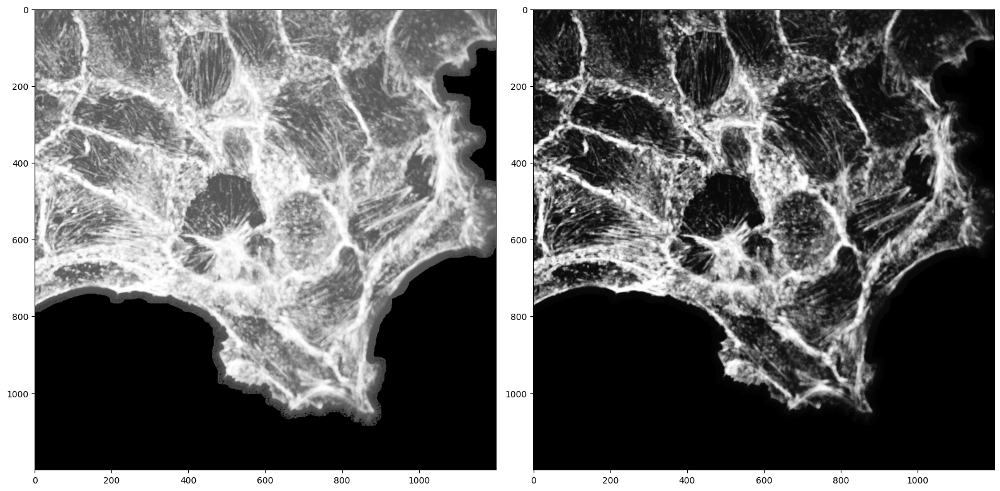

In [124]:
def gamma_correction(img, gamma):
    return (np.power(img, gamma))*255

# Define the values of gamma
gamma_values = [0.5, 1.5, 2, 3]
gamma_images = []

normalized_image = proccessed_image / 255

for i in range(len(gamma_values)):
    gamma = gamma_values[i]
    gamma_correction_image = gamma_correction(normalized_image, gamma)
    gamma_images.append(gamma_correction_image)
    show(proccessed_image, gamma_correction_image)

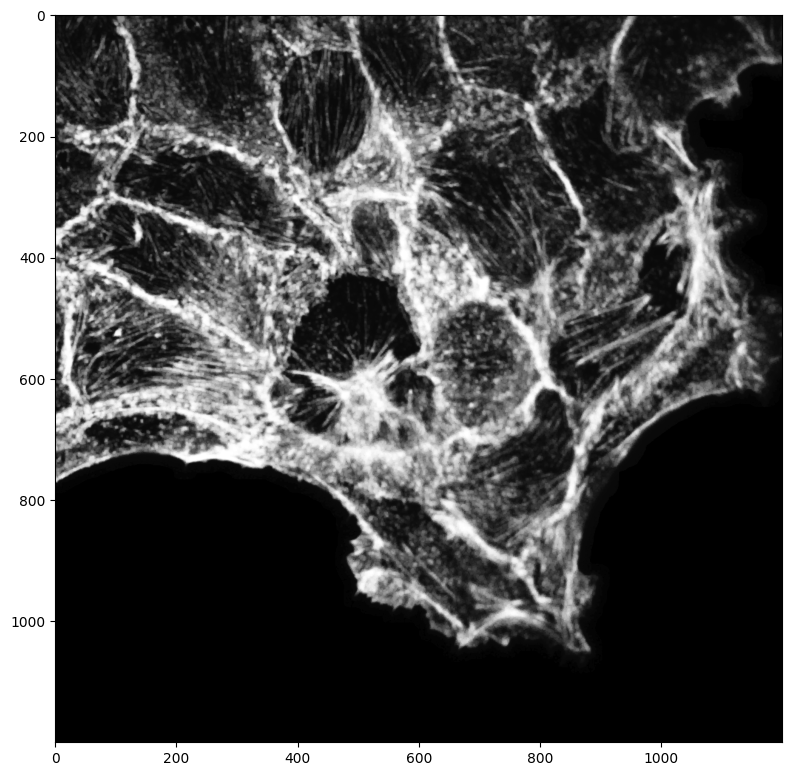

In [125]:
current_image = gamma_images[3]
show(current_image)

Let's check if the image contains noise:

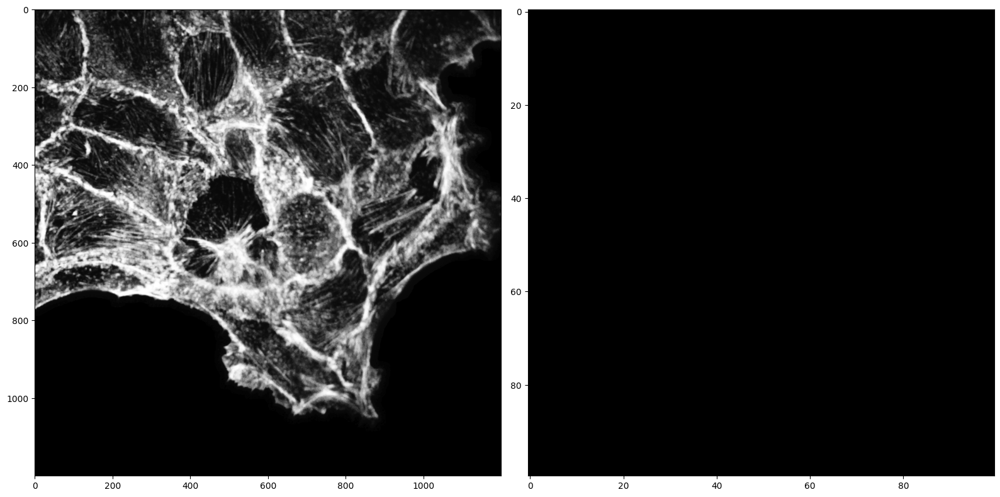

In [126]:
top_left = (1000, 1000) 
bottom_right = (1100, 1100) 

cropped_image = current_image[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]

show(current_image, cropped_image)

In [127]:
def plot_histogram(image):
    plt.hist(image.ravel(), bins=256, color='gray', alpha=0.7)
    plt.title('Histogram')
    plt.xlabel('Pixel Values')
    plt.ylabel('Frequency')
    plt.show()

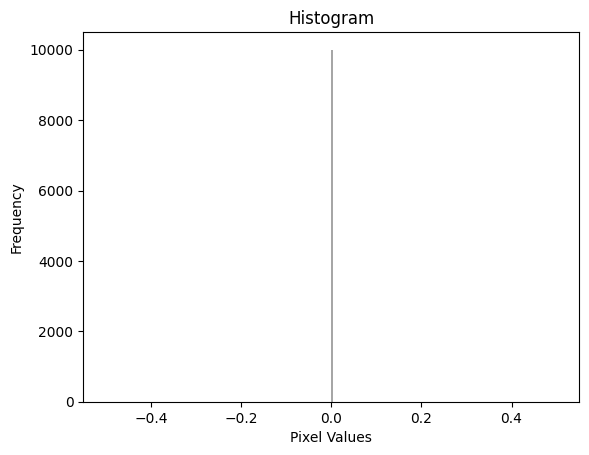

In [128]:
plot_histogram(cropped_image)

Therefore we know that there is no static noise

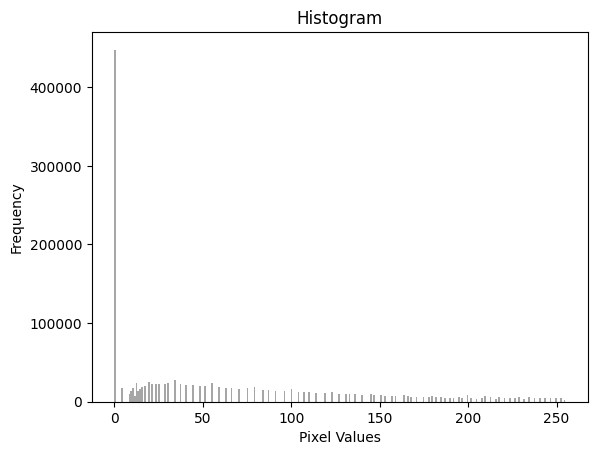

In [129]:
plot_histogram(current_image)

Original unique values: [0.00000000e+00 1.05482507e-01 4.83555556e+00 8.17287197e+00
 9.11501730e+00 9.44444444e+00 9.78171473e+00 1.01269204e+01
 1.04801538e+01 1.08415071e+01 1.12110727e+01 1.19752095e+01
 1.27733026e+01 1.36060900e+01 1.44743099e+01 1.58446905e+01
 1.72989466e+01 1.93727336e+01 2.10323875e+01 2.33890811e+01
 2.52676970e+01 2.79253825e+01 3.07631834e+01 3.45727182e+01
 3.70027528e+01 4.04163322e+01 4.40336486e+01 4.78606075e+01
 5.08719569e+01 5.50800000e+01 5.95139254e+01 6.29911572e+01
 6.66012611e+01 7.03467282e+01 7.55555556e+01 7.96265590e+01
 8.38412303e+01 8.67320569e+01 9.11917109e+01 9.58016763e+01
 1.00564444e+02 1.03825744e+02 1.07156801e+02 1.10558354e+02
 1.14031142e+02 1.19375502e+02 1.23029604e+02 1.26757524e+02
 1.30560000e+02 1.32489427e+02 1.36405121e+02 1.40397216e+02
 1.44466451e+02 1.46530227e+02 1.50716555e+02 1.52839293e+02
 1.57144375e+02 1.59326905e+02 1.63752403e+02 1.65995556e+02
 1.68259100e+02 1.70543130e+02 1.75173010e+02 1.77519047e+02


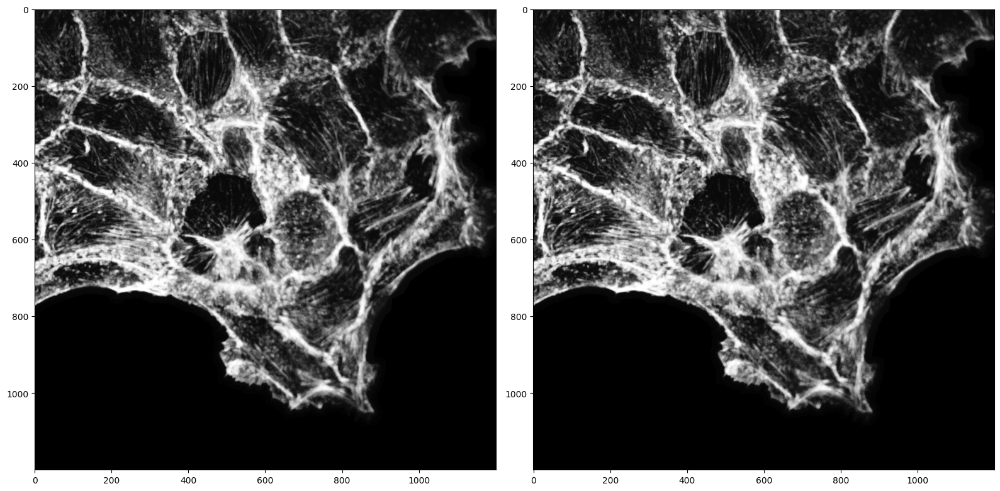

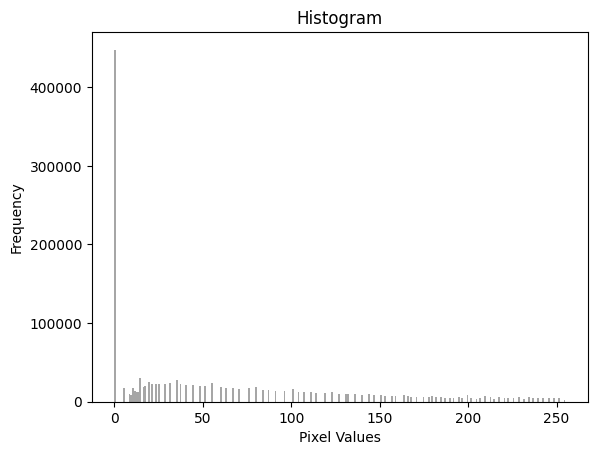

In [130]:
normalized_image = cv2.normalize(current_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)

print("Original unique values:", np.unique(current_image))
print("Normalized unique values:", np.unique(normalized_image))

show(current_image, normalized_image)

plot_histogram(normalized_image)

Now, we will threshold the image and try to detect the cells borders.

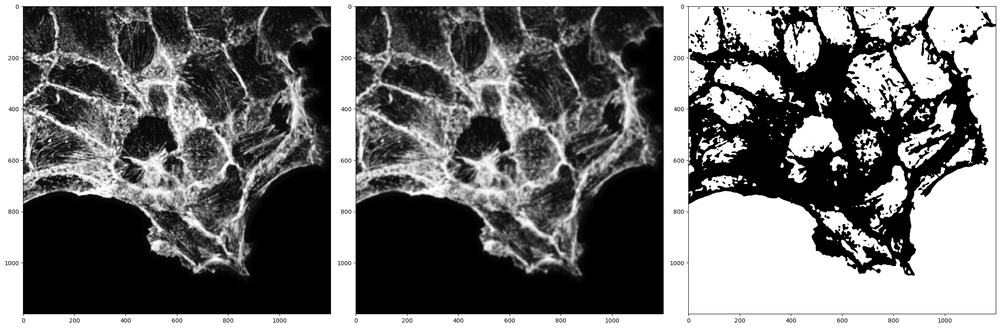

In [131]:
blur = cv2.GaussianBlur(normalized_image, (13, 13), 0)
ret, thresh = cv2.threshold(blur, 60, 255, cv2.THRESH_BINARY_INV)

show(normalized_image, blur, thresh)

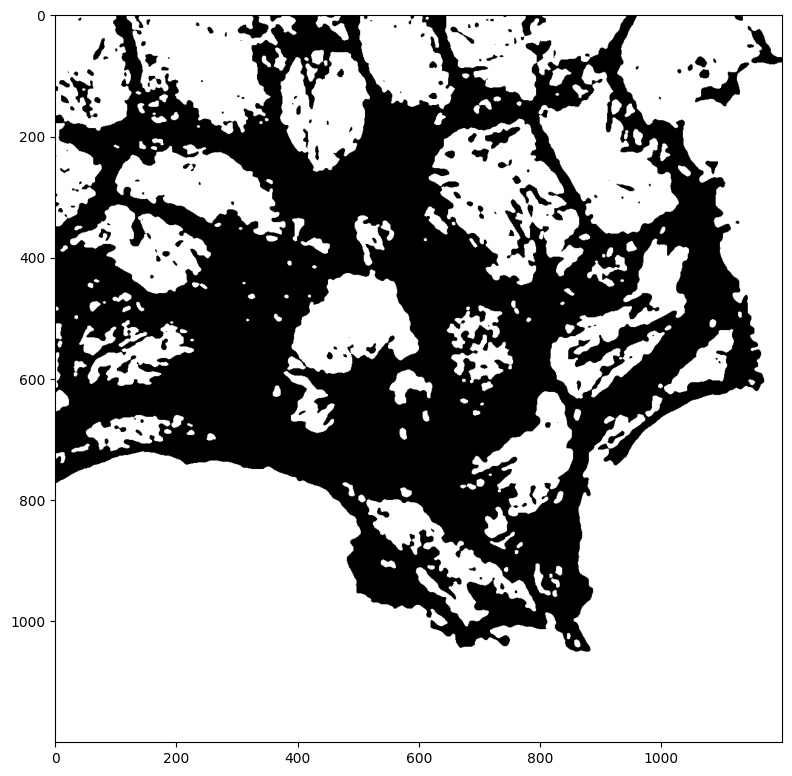

In [132]:
kernel_open = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
thresh = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel_open)
show(thresh)

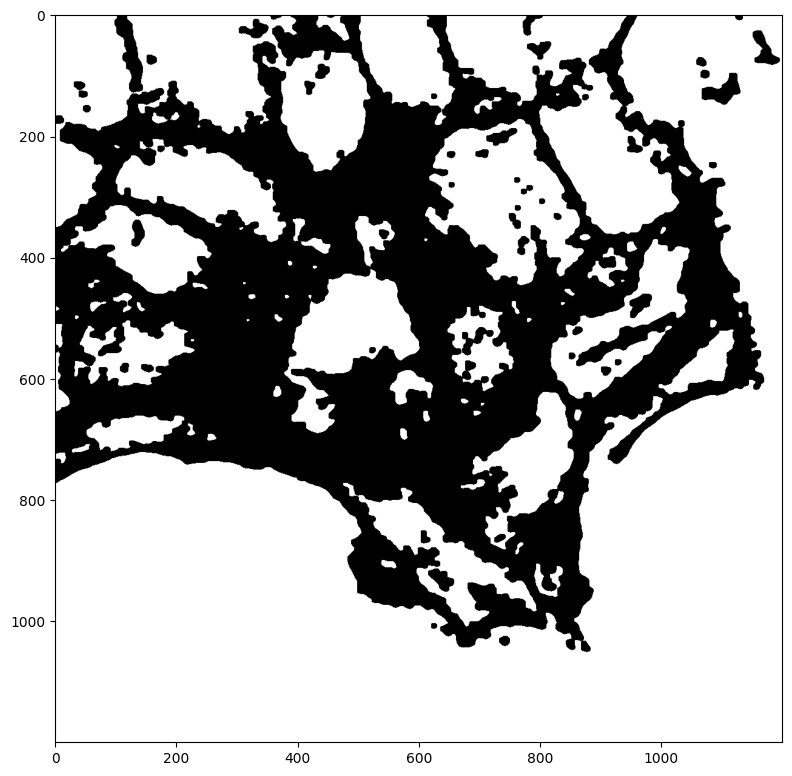

In [133]:
kernel_close = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (10, 10))
thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel_close)
show(thresh)

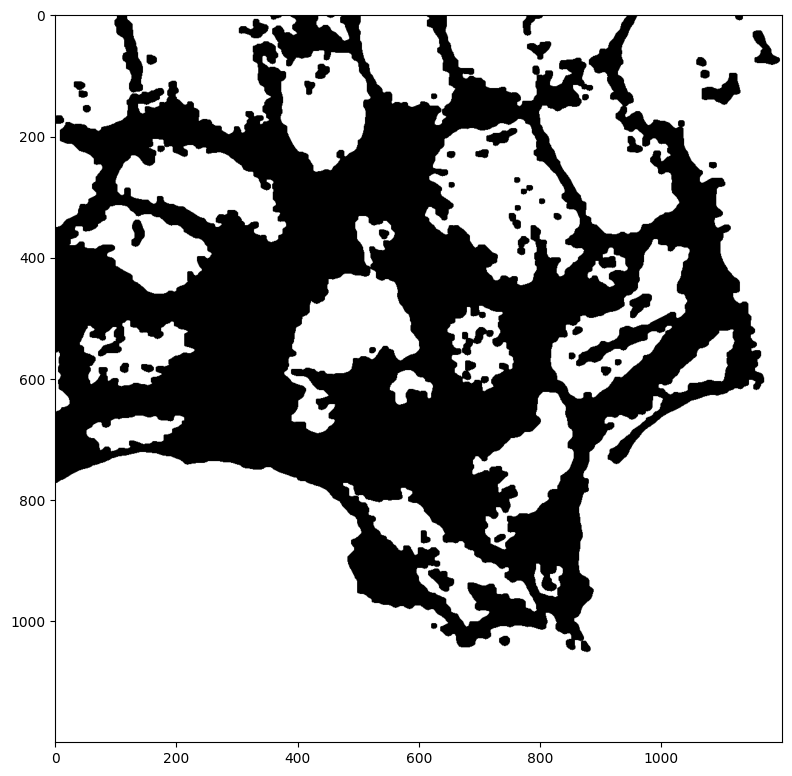

In [134]:
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(thresh, connectivity=8)

min_fiber_length = 50
cells_mask = np.zeros_like(thresh)

for i in range(1, num_labels):
    if max(stats[i, cv2.CC_STAT_WIDTH], stats[i, cv2.CC_STAT_HEIGHT]) > min_fiber_length:
        cells_mask[labels == i] = 255

show(cells_mask)

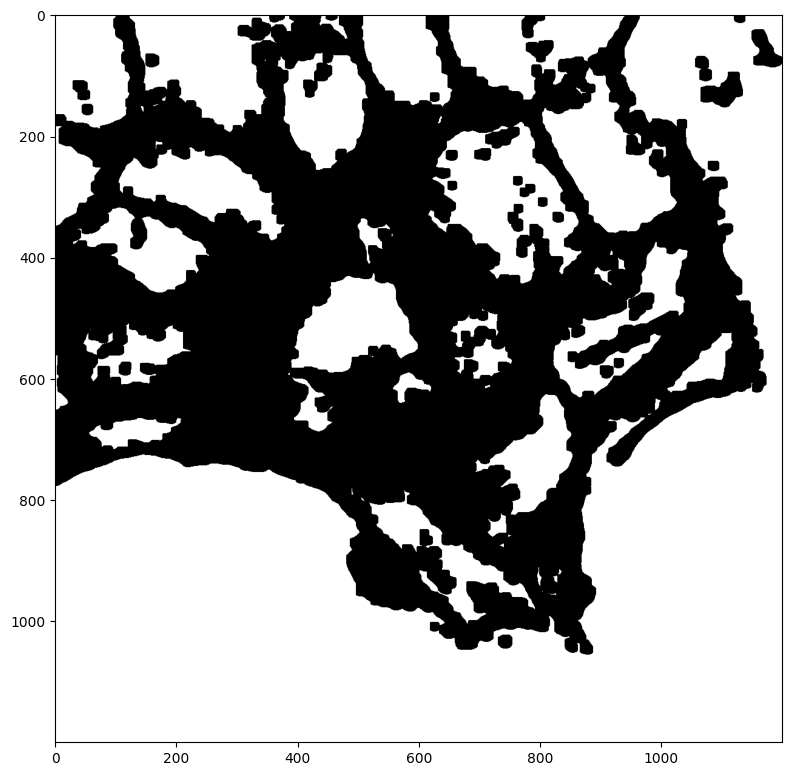

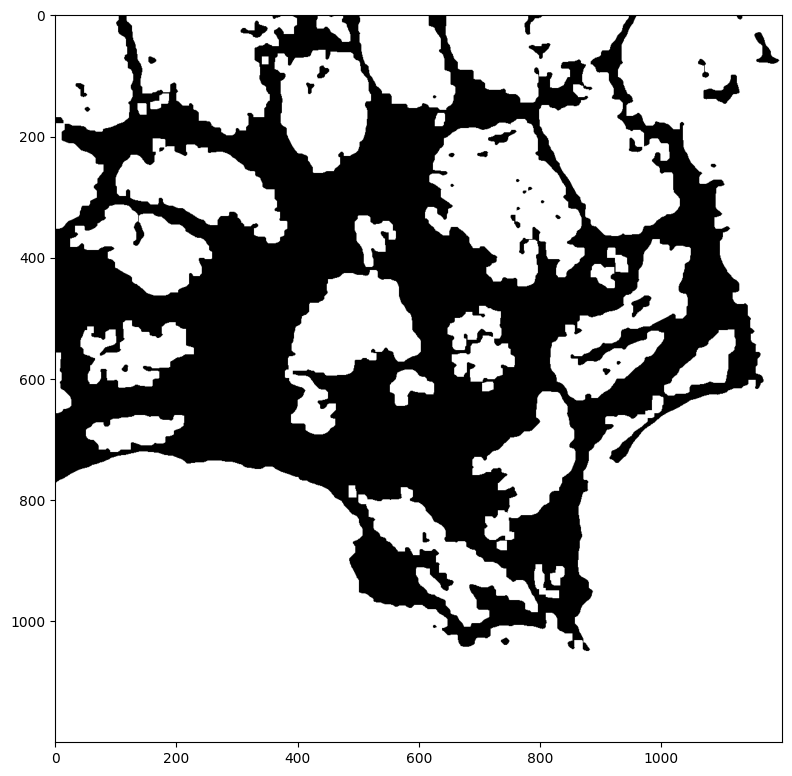

In [135]:
shape = cv2.MORPH_RECT
kernel_size = (4,)*2
kernel = cv2.getStructuringElement(shape, kernel_size)
cells_mask = cv2.erode(cells_mask, kernel, iterations=2)
show(cells_mask)

kernel_size = (11,)*2
kernel = cv2.getStructuringElement(shape, kernel_size)
cells_mask = cv2.dilate(cells_mask, kernel)
show(cells_mask)

Eventually, we have:

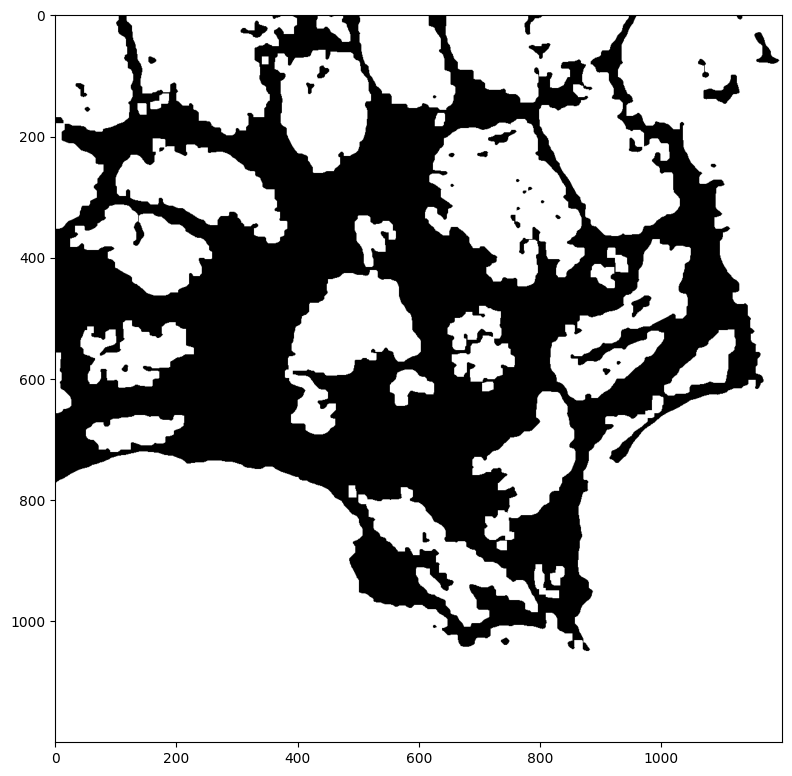

In [136]:
show(cells_mask)

To enhance the visibility of fibers in an image, we subtract the cell borders from the image. 

By subtracting the cell borders, the image can be processed in a way that the fibers become more prominent and easier to distinguish.

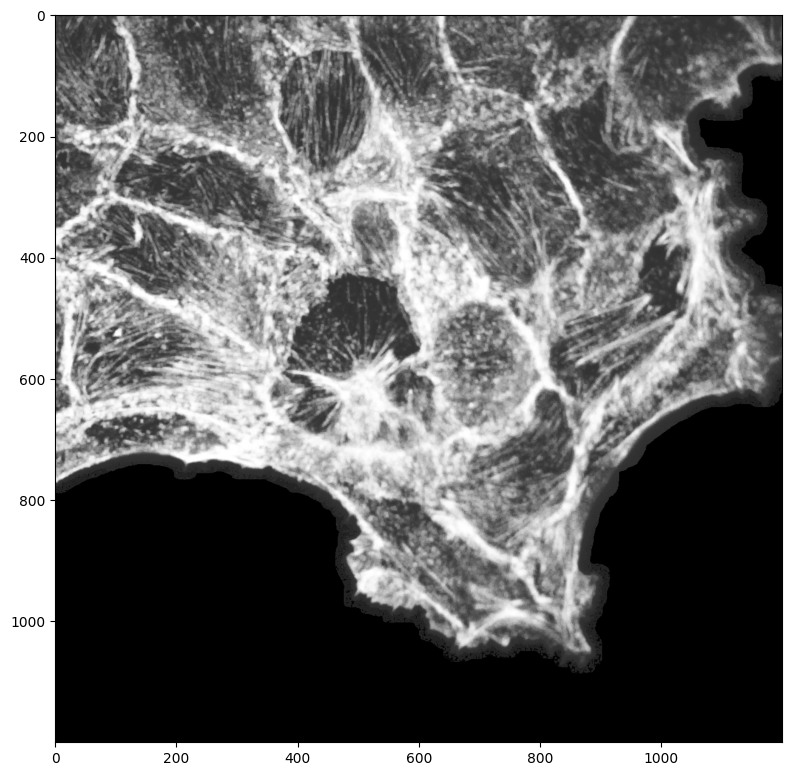

In [137]:
test = gamma_images[1].copy()
# test[cells_mask == 0] = 0
# test[gamma_images[1] <= 48]=0
show(test)

Among the three approaches, the third method appears to provide the most accurate detection of cell borders.

Now we will try to detect the fibers

In [138]:
def equalize_hist(img):
    hist, bins = np.histogram(img.flatten(), bins=256, range=[0,255])
    cdf = hist.cumsum()
    cdf_normalized = cdf * hist.max() / cdf.max()
    cdf_m = np.ma.masked_equal(cdf, 0)
    cdf_m = (cdf_m - cdf_m.min()) * 255 / (cdf_m.max() - cdf_m.min())
    cdf = np.ma.filled(cdf_m, 0).astype('uint8')
    
    img_out = cdf[img.flatten().astype('uint8')]
    img_out = np.reshape(img_out, img.shape)

    return img_out

def normalize(img):
    return (img - np.min(img))/(np.max(img)- np.min(img))*255

def convert_gray_to_rgb(image):
    image_rgb = np.stack((image,)*3, axis=-1)
    return image_rgb

def threshold_image(image, threshold=10, max_value=255):
    thresholded_image = np.where(image > threshold, max_value, 0).astype('uint8')
    return thresholded_image

In [139]:
def get_structuring_element(size):
    return np.ones(size, np.uint8)

def dilation(image, selem):
    padded_image = np.pad(image, ((selem.shape[0]//2, selem.shape[0]//2), (selem.shape[1]//2, selem.shape[1]//2)), 'constant')
    dilated_image = np.zeros_like(image)
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            dilated_image[i, j] = np.max(padded_image[i:i+selem.shape[0], j:j+selem.shape[1]][selem==1])
    return dilated_image

def erosion(image, selem):
    padded_image = np.pad(image, ((selem.shape[0]//2, selem.shape[0]//2), (selem.shape[1]//2, selem.shape[1]//2)), 'constant')
    eroded_image = np.zeros_like(image)
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            eroded_image[i, j] = np.min(padded_image[i:i+selem.shape[0], j:j+selem.shape[1]][selem==1])
    return eroded_image

def opening(image, selem):
    return dilation(erosion(image, selem), selem)

def top_hat_transform(image, selem):
    return image - opening(image, selem)

In [140]:
def identify_fibers(image):
    selem = get_structuring_element((1, 15))
    tophat = top_hat_transform(image, selem)
    tophat = threshold_image(tophat, 40, 255)
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(tophat, connectivity=8)

    min_fiber_length = 20
    fiber_mask = np.zeros_like(tophat)

    for i in range(1, num_labels):
        if max(stats[i, cv2.CC_STAT_WIDTH], stats[i, cv2.CC_STAT_HEIGHT]) > min_fiber_length:
            fiber_mask[labels == i] = 255

    lines = cv2.HoughLinesP(fiber_mask, rho=1, theta=np.pi/180, threshold=10, minLineLength=5, maxLineGap=10)
    image_color = convert_gray_to_rgb(normalized_image)

    color_mask = np.zeros_like(image_color)
    color_mask[fiber_mask == 255] = [0, 0, 255]
    
    highlighted_image = cv2.addWeighted(image_color, 1.0, color_mask, 0.5, 0)

    show(normalized_image,image, fiber_mask, highlighted_image)

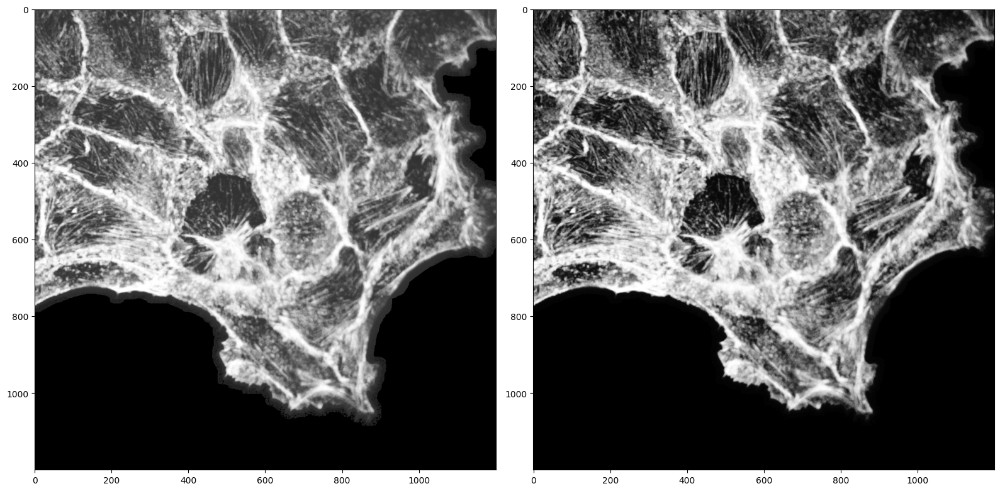

In [141]:
equalized_image = equalize_hist(test)
show(test, equalized_image)

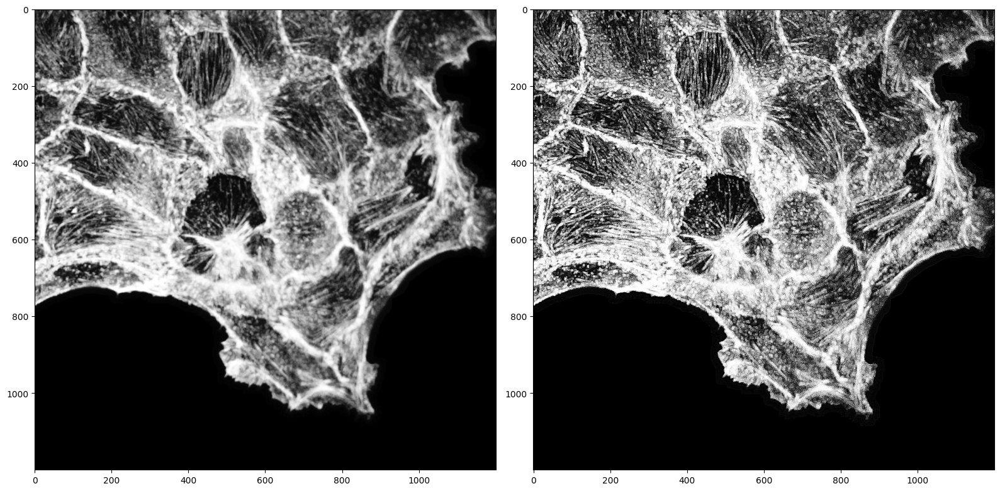

In [142]:
def sharpen_image(image):
    kernel = np.array([[-1, -1, -1],
                       [-1,  9, -1],
                       [-1, -1, -1]])

    sharpened_image = cv2.filter2D(image, -1, kernel)

    return sharpened_image

sharpened_image = sharpen_image(equalized_image)
show(equalized_image, sharpened_image)

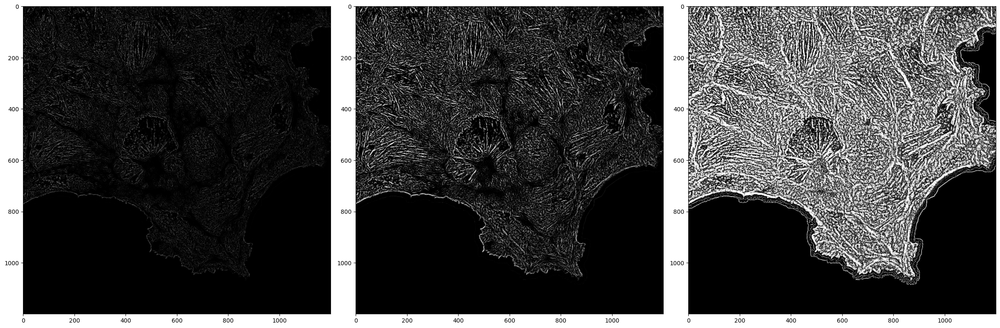

In [143]:
from skimage.filters import frangi

filtered_frangi = frangi(sharpened_image, np.arange(1,7, 1), black_ridges=False)
filtered_frangi1 = frangi(sharpened_image, np.arange(0.5,3, 0.8), beta=0.3, black_ridges=False)
filtered_frangi2 = frangi(sharpened_image, np.arange(0.5,3, 0.8), beta=0.3, gamma=0.7, black_ridges=False)

show(filtered_frangi, filtered_frangi1, filtered_frangi2)

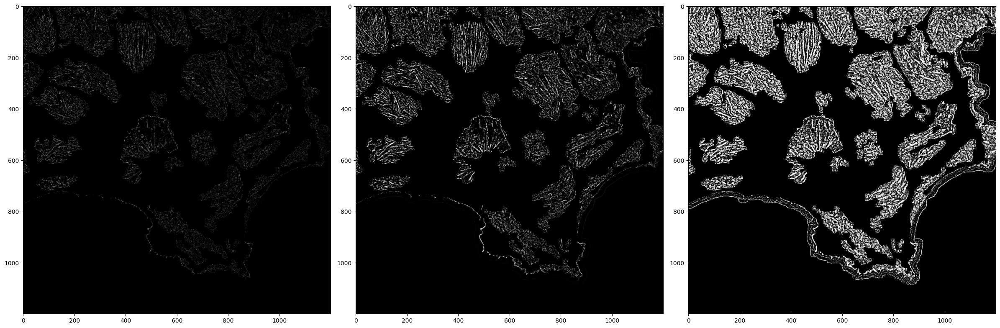

In [144]:
filtered_frangi[cells_mask == 0] = 0  
filtered_frangi1[cells_mask == 0] = 0 
filtered_frangi2[cells_mask == 0] = 0 

show(filtered_frangi, filtered_frangi1, filtered_frangi2)

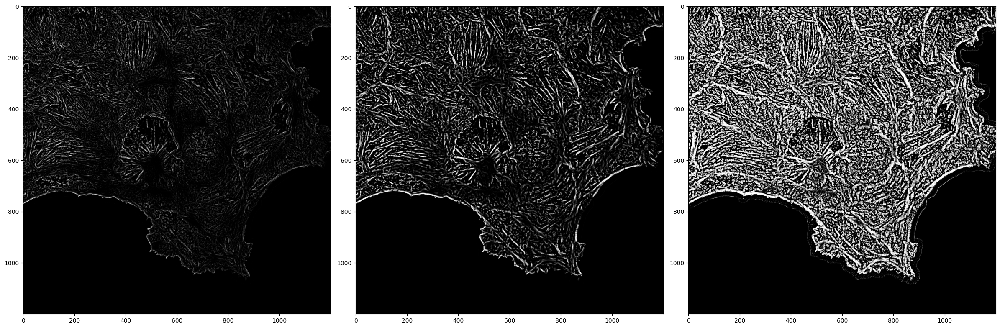

In [145]:

filtered_frangi = frangi(equalized_image, np.arange(0.6,3, 0.3), black_ridges=False)
filtered_frangi1 = frangi(equalized_image, np.arange(0.5,3, 1.5), beta=0.3, black_ridges=False)
filtered_frangi2 = frangi(equalized_image, np.arange(0.5,3, 0.8), beta=0.3, gamma=0.7, black_ridges=False)

show(filtered_frangi, filtered_frangi1, filtered_frangi2)

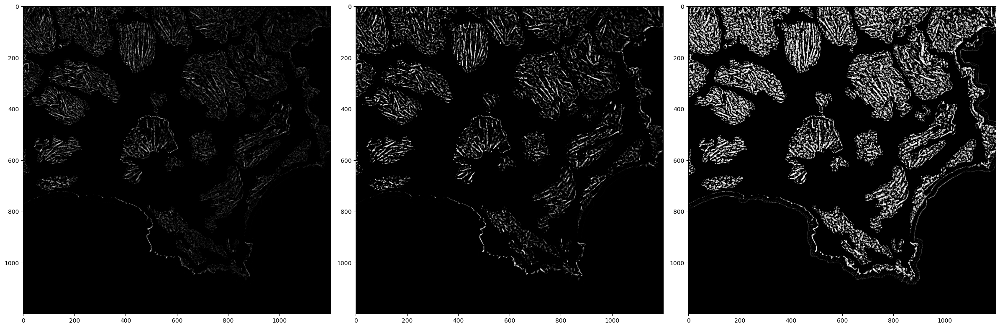

In [147]:
filtered_frangi[cells_mask == 0] = 0  
filtered_frangi1[cells_mask == 0] = 0 
filtered_frangi2[cells_mask == 0] = 0 


show(filtered_frangi, filtered_frangi1, filtered_frangi2)

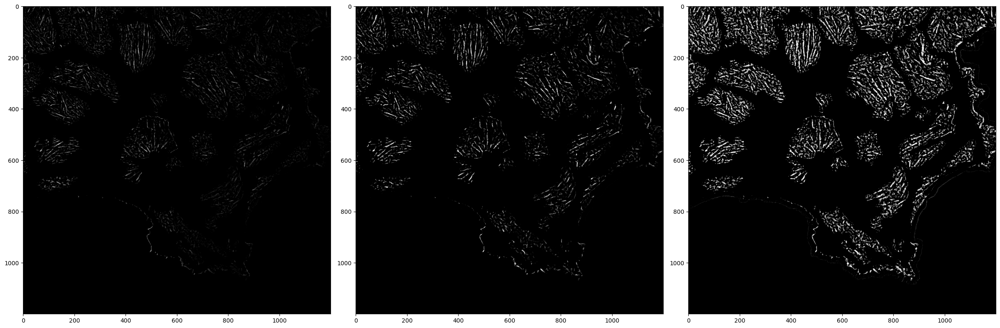

In [148]:
filtered_frangi = minimum_filter(filtered_frangi, 2)  
filtered_frangi1 = minimum_filter(filtered_frangi1, 2) 
filtered_frangi2 = minimum_filter(filtered_frangi2, 2) 


show(filtered_frangi, filtered_frangi1, filtered_frangi2)

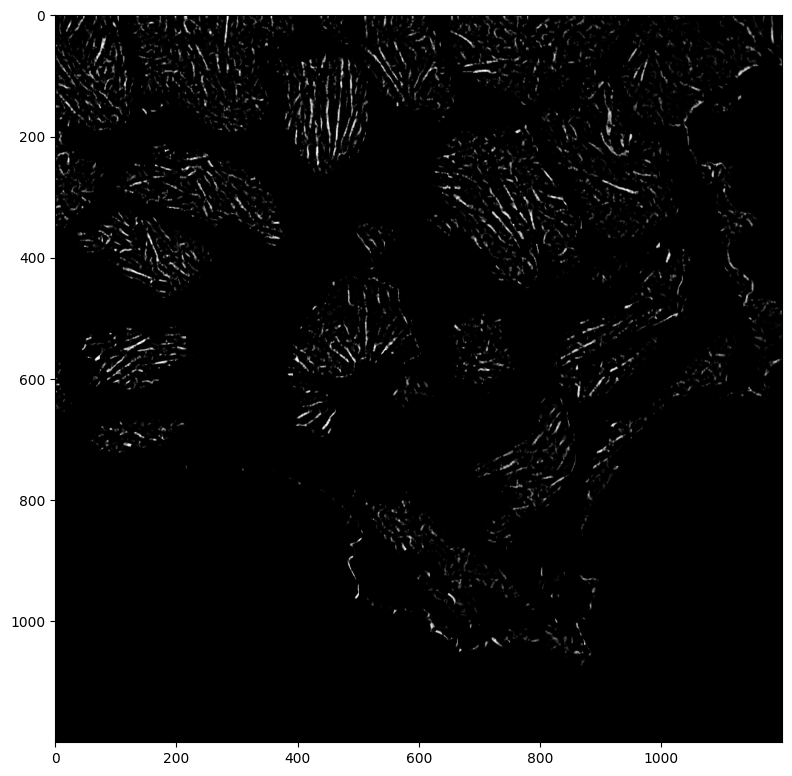

In [149]:
ed_frangi = cv2.dilate(filtered_frangi1, (10,)*2)
ed_frangi = cv2.erode(ed_frangi, (5,)*2)

ed_frangi = cv2.dilate(ed_frangi, (9,)*2)
ed_frangi = cv2.erode(ed_frangi, (3,)*2)

ed_frangi = cv2.erode(ed_frangi, (5,)*2)
ed_frangi = cv2.dilate(ed_frangi, (5,)*2)

ed_frangi = cv2.erode(ed_frangi, (15,)*2)
ed_frangi = cv2.dilate(ed_frangi, (5,)*2)

show(ed_frangi)

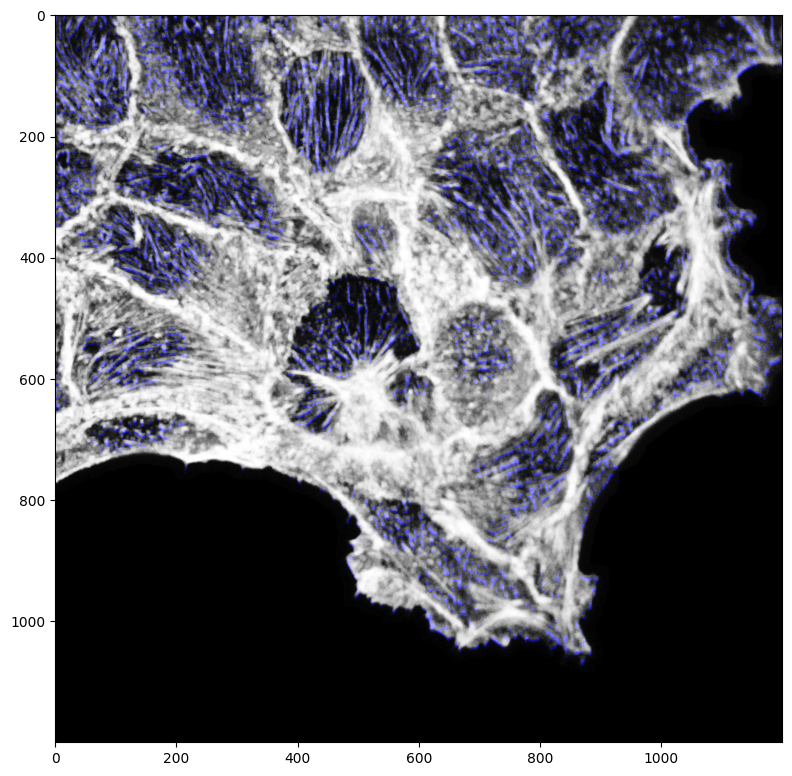

In [151]:
image_color = convert_gray_to_rgb(equalized_image)

color_mask = np.zeros_like(image_color)
color_mask[ed_frangi > ed_frangi.mean()] = [0, 0, 255]
highlighted_image = cv2.addWeighted(image_color, 1.0, color_mask, 0.5, 0)
show(highlighted_image)

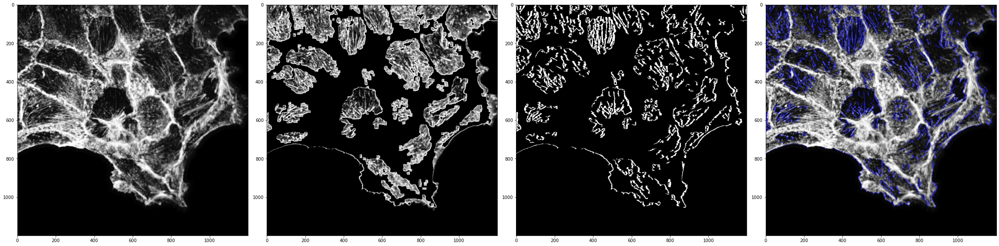

In [28]:
identify_fibers(equalized_image)

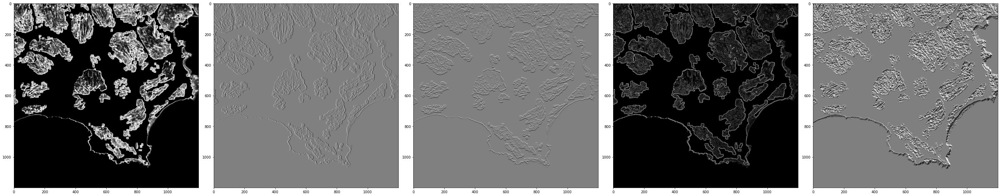

In [29]:
sobel_x = cv2.Sobel(equalized_image, cv2.CV_64F, 1, 0, ksize=3)
sobel_y = cv2.Sobel(equalized_image, cv2.CV_64F, 0, 1, ksize=3)

gradient_magnitude = np.sqrt(sobel_x**2 + sobel_y**2)
gradient_direction = np.arctan2(sobel_y, sobel_x)

gradient_magnitude_normalized = cv2.normalize(gradient_magnitude, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
show(equalized_image, sobel_x, sobel_y, gradient_magnitude_normalized, gradient_direction)

In [30]:
def CannyEdgeDetector(input_image, threshold1, threshold2):
    input_image = cv2.GaussianBlur(input_image, (5, 5), np.sqrt(2))
    input_image = cv2.normalize(input_image, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    grad = cv2.Canny(input_image, threshold1, threshold2)
    
    strong = grad > threshold2
    weak = (grad > threshold1) & (grad <= threshold2)
    
    result = np.zeros_like(grad, dtype=np.uint8)
    result[strong] = 255

    for (i, j), value in np.ndenumerate(weak):
        if value:
            if np.any(strong[i-1:i+2, j-1:j+2]):
                result[i, j] = 255
    
    return result

def detect_lines(image, rho=1, theta=np.pi/180, threshold=10, min_line_len=40, max_line_gap=20):
    lines = cv2.HoughLinesP(image, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_image = np.zeros((image.shape[0], image.shape[1], 3), dtype=np.uint8)

    if lines is not None:  
        for line in lines:
            for x1,y1,x2,y2 in line:
                cv2.line(line_image, (x1, y1), (x2, y2), [255, 0, 0], 2)
    else:
        print("No line was detected")
        
    return line_image

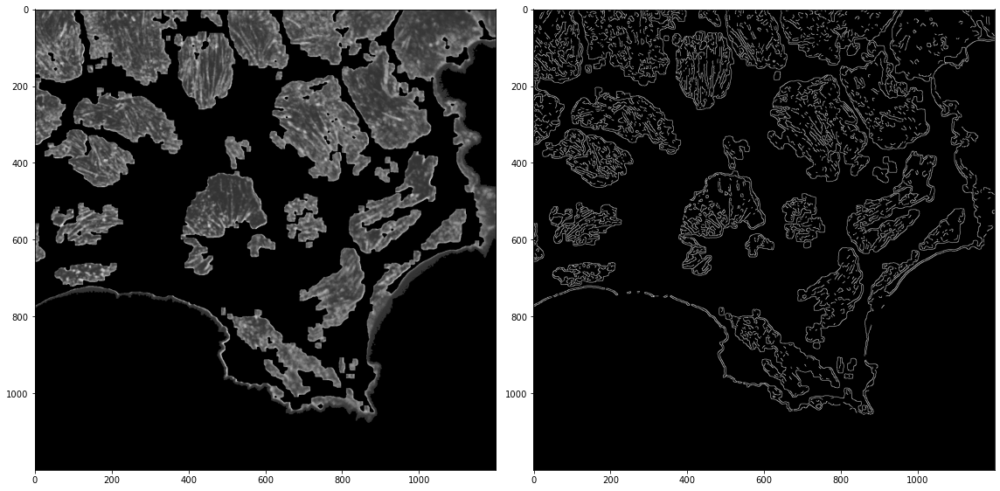

In [31]:
edge_image = CannyEdgeDetector(equalized_image, 200, 250) 
show(test, edge_image)